# scVI data integration of TEC compartment

In [1]:
import sys 
import os
from datetime import datetime

import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
import scvi
import hdf5plugin

import matplotlib.pyplot as plt
import seaborn as sns

# Add repo path to sys path (allows to access scripts and metadata from repo)
repo_path = os.path.split(os.getcwd())[0]
sys.path.insert(1, repo_path) 
sys.path.insert(2, '/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/data')

import torch
torch.cuda.is_available()


False

In [2]:
sys.path.append('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/scripts')
from scvi_wrapper2 import run_scvi

In [3]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100
import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

In [4]:
# Define plot and path dirs
plot_path = os.path.join(repo_path, 'plots')
data_path = os.path.join(repo_path, 'data')
model_path = os.path.join(repo_path, 'models')
general_data_path = '/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/data'

In [5]:
tec_mrkrs = {'pan-cTEC':['PSMB11', 'LY75', 'CCL25', 'HLA-DRA'],
        'cTEC\nsubtypes':['DLL4', 'TP53AIP1', 'TBATA'],
        'mcTEC':['DLK2','IGFBP5', 'IGFBP6','CCN2', 'CCL2',
              'KRT15', 'ITGA6', 'MKI67'],
        'pan-mTEC': ['EPCAM'],
        'mTECI': ['ASCL1','CCL21'],
        'mTECII': ['AIRE', 'FEZF2','CRIP1'], 
        'mTECIII':['SLPI', 'IVL', 'KRT10','CDKN2A'],
        'pan-neuro TEC': ['BEX1', 'NEUROD1'],
        'neuroTEC': ['NEUROG1', 'NEUROD4'], 
        'cilliated TEC': ['PCP4', 'FOXJ1'], 
        'myoTEC':['CHRNA1', 'MYOG', 'TTN'],
        'ionocytes':['FOXI1', 'CFTR'],
        'tuft cells':['POU2F3','PLCB2', 'TRPM5']}

tec_mrkrs_lst = []
[tec_mrkrs_lst.extend(tec_mrkrs[key]) for key in tec_mrkrs.keys()]

[None, None, None, None, None, None, None, None, None, None, None, None, None]

In [6]:
def regen_embed (adata, anno2show):
    sc.pp.neighbors(adata, use_rep = 'X_scVI')
    sc.tl.umap(adata, min_dist = 0.1, spread = 1)
    sc.pl.umap(adata, color = anno2show)
    return (adata)

In [7]:
def remove_small_samples(adata, sample_anno = 'sample', less_than=3):
    samples2remove = adata.obs[sample_anno].value_counts().loc[(adata.obs[sample_anno].value_counts()<less_than)].index.tolist()
    print(samples2remove)
    n_cells_orig = adata.shape[0]
    adata = adata[~adata.obs[sample_anno].isin(samples2remove),:].copy()
    n_cells = adata.shape[0]
    print(f'{str(n_cells_orig-n_cells)} cells were removed')
    return(adata)


In [8]:
def run_leiden(adata, resolutions, key_name,restrict_to = None, legend_loc = "on data", legend_fontsize = 4):
    for r in resolutions:
        if restrict_to:
            sc.tl.leiden(adata, restrict_to = restrict_to, resolution = r, key_added = f'{key_name}-leiden_r{str(r)}',
                        flavor="igraph", n_iterations=2)
        else:
            sc.tl.leiden(adata, resolution = r, key_added = f'{key_name}-leiden_r{str(r)}',
                        flavor="igraph", n_iterations=2)
    sc.pl.umap(adata, color = [f'{key_name}-leiden_r{str(r)}' for r in resolutions] , legend_loc = legend_loc, legend_fontsize = legend_fontsize)


## Load data

In [8]:
adata = ad.read_h5ad (f'{data_path}/objects/thyAgeing_scvi_v3_2024-11-05_tec-fb-vascSplit_TEC_v3_2layers_300epochs_batch-sample2025-01-10.zarr')


In [11]:
adata_filt = remove_small_samples(adata, sample_anno = 'sample')

['T06_TH_TOT_5GEX_1_S9', 'A16_TH_TOT_3', 'A16_TH_TOT_2', 'A16_TH_TOT_5GEX_4', 'Z11-THY--SC-45N-1', 'D4_TyDiss', 'A16_TH_TOT_5GEX_3', 'A16_TH_TOT_1', 'A16_TH_TOT_4', 'Z11-THY--SC-3N-1', 'A66-THY-0-SC-2_5GEX', 'U09-THY--SC-1', 'sample1']
18 cells were removed


In [16]:
adata_filt.obs.drop(columns=['TEC-leiden_r0.6', 'TEC-leiden_r0.8',
       'TEC-leiden_r1.0', 'TEC-leiden_r1.2', 'doublet2', 'TEC-leiden_r1.4',
       'TEC_anno1', 'iono-leiden_r0.2', 'iono-leiden_r0.6',
       'iono-leiden_r0.8'], inplace = True)

In [21]:
adata = adata_filt.copy()

del adata_filt

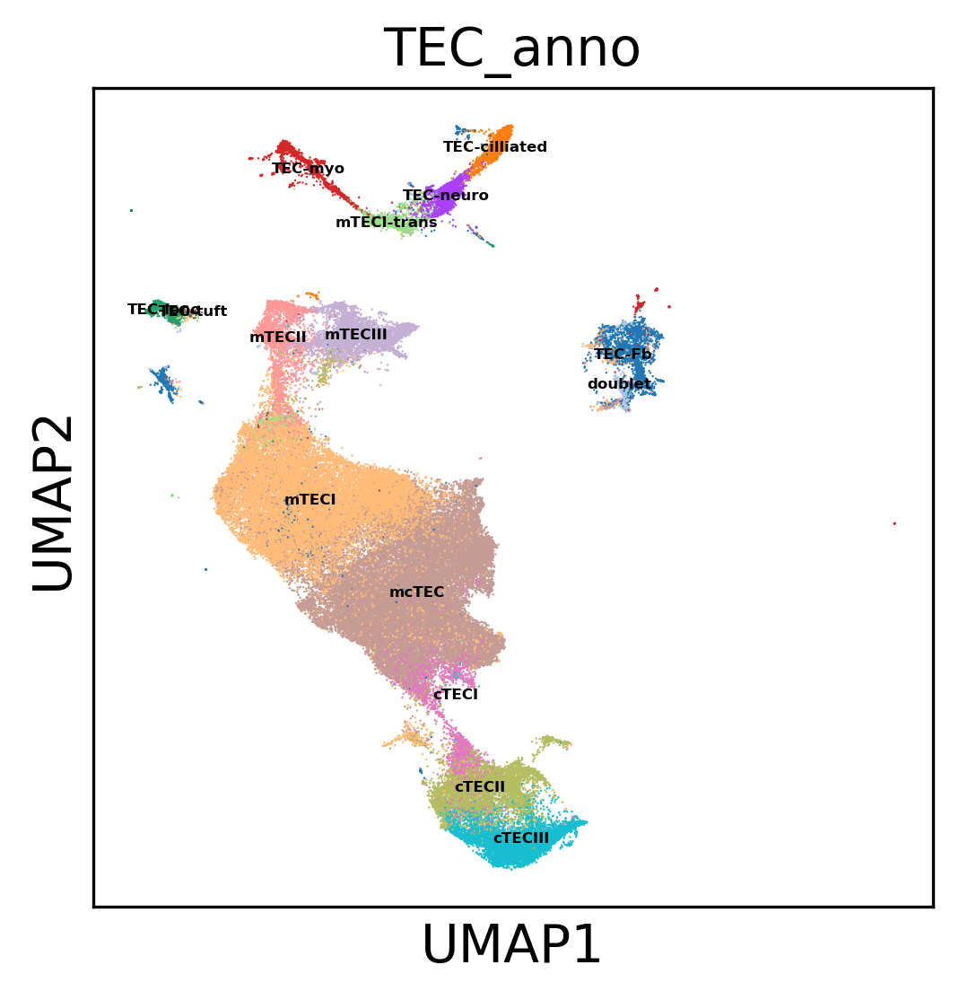

In [23]:
sc.pl.umap(adata, color = 'TEC_anno', legend_loc = 'on data', legend_fontsize = 4)

In [25]:
adata.obs['study'].value_counts()

study
Thymus_ageing        37460
Notarangelo2024      24127
Park2020              9363
Yayon2024             9202
Bautista2021          4557
Heimli2024            4161
Campinoti2020         1144
Li2024                 340
TabulaSapiens2022      100
Name: count, dtype: int64

## Run scVI integration

Removed excluded genes


An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


Highly variable genes selected in total (90454, 10000)


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/nfs/team205/vk8/mambaforge/envs/scvi-env3/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=4` in the `DataLoader` to improve performance.
/nfs/team205/vk8/mambaforge/envs/scvi-env3/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=4` in the `DataLoader` to improve performance.


Epoch 400/400: 100%|██████████████████████████████████████████████████| 400/400 [52:31<00:00,  7.88s/it, v_num=1, train_loss_step=1.64e+3, train_loss_epoch=1.67e+3]

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|██████████████████████████████████████████████████| 400/400 [52:31<00:00,  7.88s/it, v_num=1, train_loss_step=1.64e+3, train_loss_epoch=1.67e+3]
scVI model trained
UMAP performed


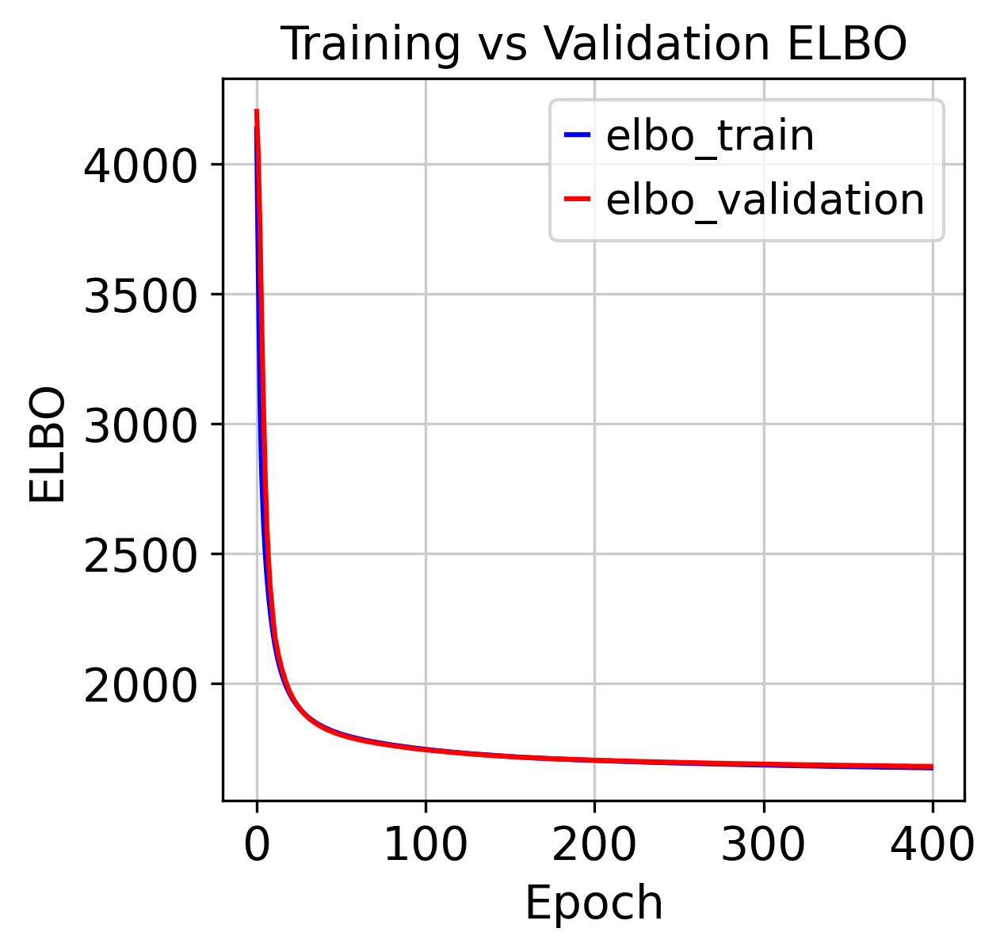

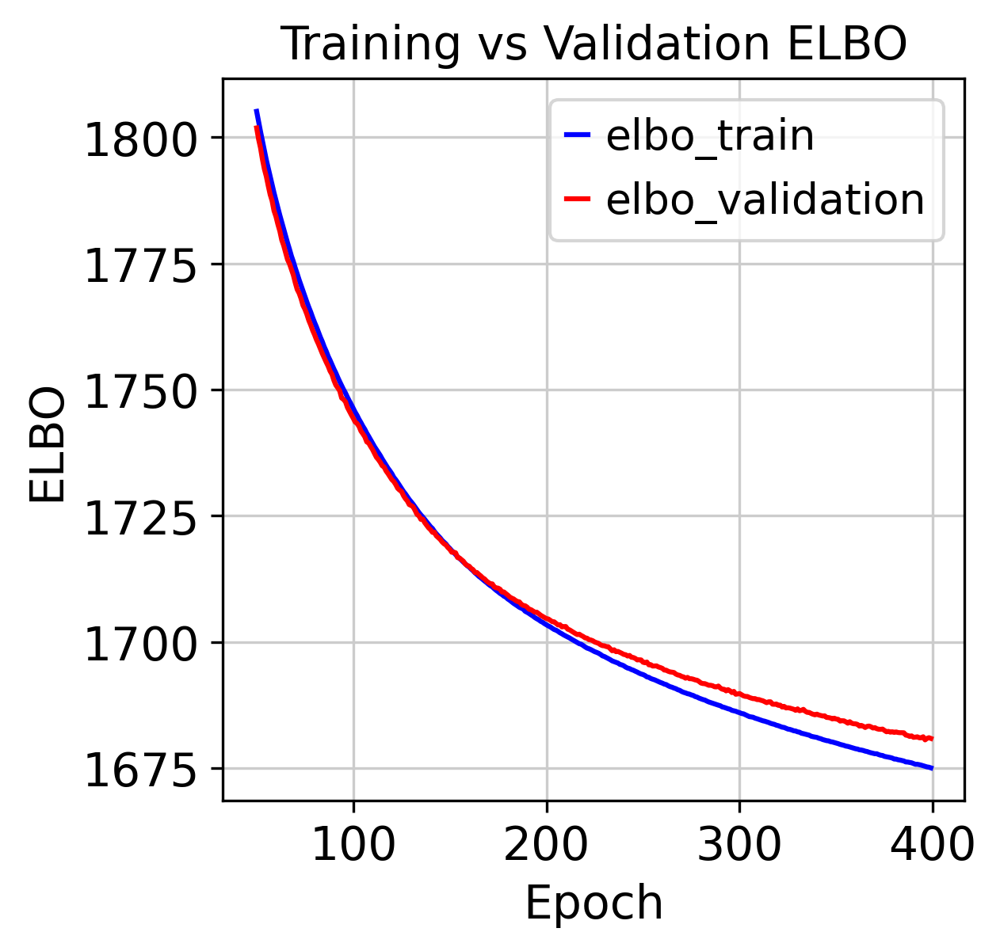

Plotting doublet_metric
Plotting age
Plotting batch_mixing
Plotting cat_covs


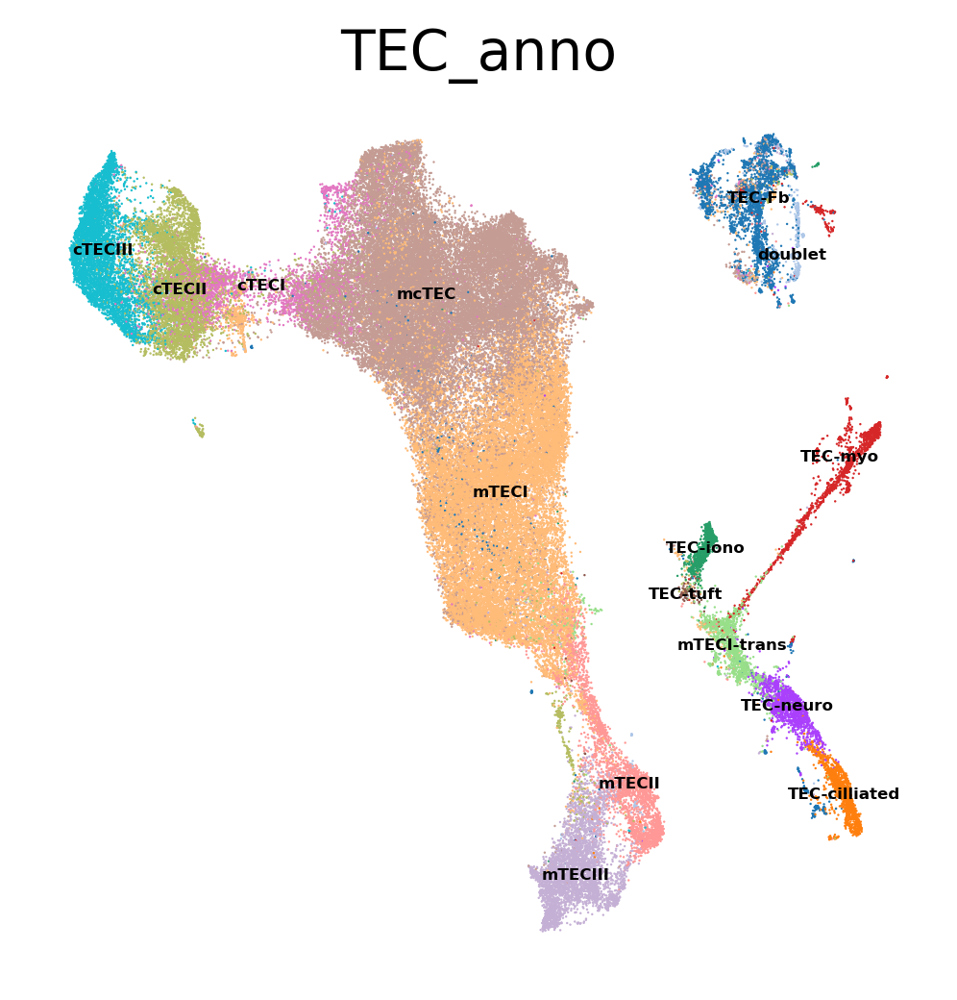

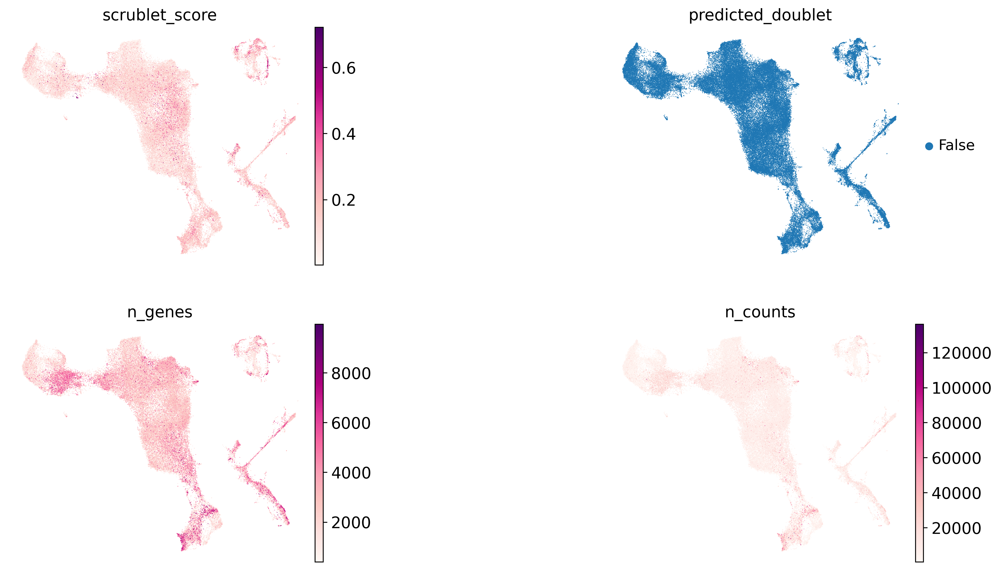

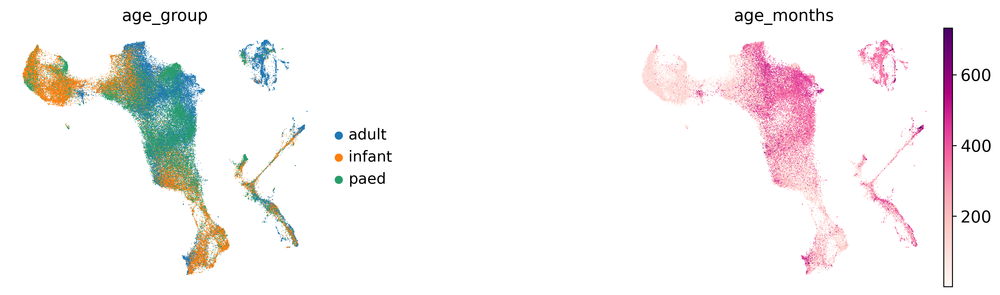

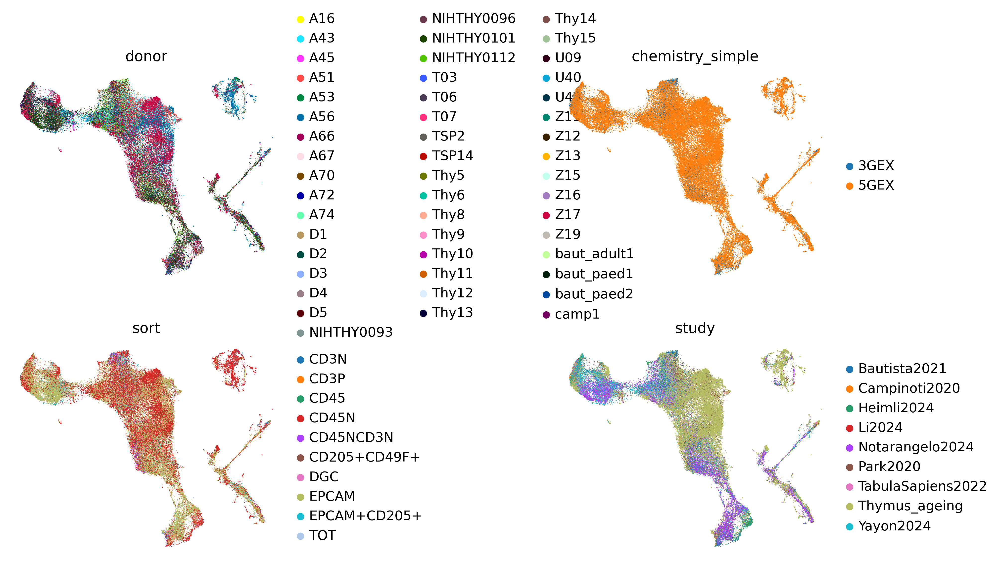

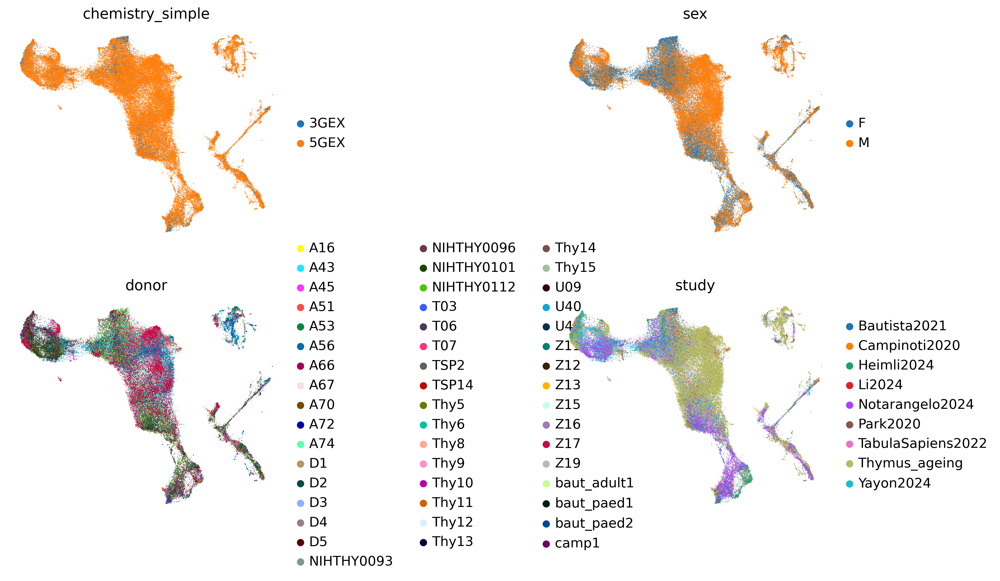

In [26]:
scvi_run = run_scvi(adata, 
                    # Excluded genes
                    include_genes=[], exclude_cc_genes=True, exclude_mt_genes=True, 
                    exclude_vdjgenes = True, remove_cite = False,
                    # Highly variable gene selection
                    batch_hv="age_group", hvg = 10000, span = 0.5,
                    # scVI 
                    batch_scvi="sample",
                    cat_cov_scvi=["chemistry_simple", "sex", "donor", "study"], 
                    cont_cov_scvi=None, 
                    max_epochs=400, batch_size=2000, #early_stopping = True, early_stopping_patience = 10, early_stopping_min_delta = 10,
                    plan_kwargs = {'lr': 0.0001}, n_layers = 2, n_latent = 30, dispersion = 'gene-batch',
                    check_val_every_n_epoch = 1,
                    covs = {'doublet_metric': ['scrublet_score', 'predicted_doublet', 'n_genes', 'n_counts'],
                    'age': ['age_group', 'age_months'],
                    'batch_mixing': ['donor', 'chemistry_simple', 'sort', 'study']}, 
                    # Leiden clustering
                    leiden_clustering = None, col_cell_type = 'TEC_anno')

In [34]:
def run_leiden(adata, resolutions, key_name,restrict_to = None, legend_loc = "on data", legend_fontsize = 4):
    for r in resolutions:
        if restrict_to:
            sc.tl.leiden(adata, restrict_to = restrict_to, resolution = r, key_added = f'{key_name}-leiden_r{str(r)}',
                        flavor="igraph", n_iterations=2)
        else:
            sc.tl.leiden(adata, resolution = r, key_added = f'{key_name}-leiden_r{str(r)}',
                        flavor="igraph", n_iterations=2)
    sc.pl.umap(adata, color = [f'{key_name}-leiden_r{str(r)}' for r in resolutions] , legend_loc = legend_loc, legend_fontsize = legend_fontsize)


In [27]:
# Save adata and scvi model
scvi_embed_version = 'scvi_v3_2024-11-05_tec-fb-vascSplit'
scvi_obj_version = f'TEC_v4_2layers_400epochs_batch-sample{datetime.now().strftime("%Y-%m-%d")}'
overwrite = True

#anno_cols = [c for c in scvi_run['data'].obs.columns if '_pred_' in c or '_prop_' in c]
if not os.path.exists(f'{data_path}/thyAgeing_{scvi_embed_version}_{scvi_obj_version}.zarr') or overwrite:
#    scvi_run['data'].obs = scvi_run['data'].obs.drop(columns=anno_cols)
    scvi_run['data'].write_h5ad(
        f'{data_path}/objects/thyAgeing_{scvi_embed_version}_{scvi_obj_version}.zarr',
        compression=hdf5plugin.FILTERS["zstd"],
        compression_opts=hdf5plugin.Zstd(clevel=5).filter_options,
    )
    scvi_run['vae'].save(f'{model_path}/thyAgeing_{scvi_embed_version}_{scvi_obj_version}', save_anndata=False, overwrite=False)
else:
    print('File already exists')



In [30]:
adata  = scvi_run['data'].copy()

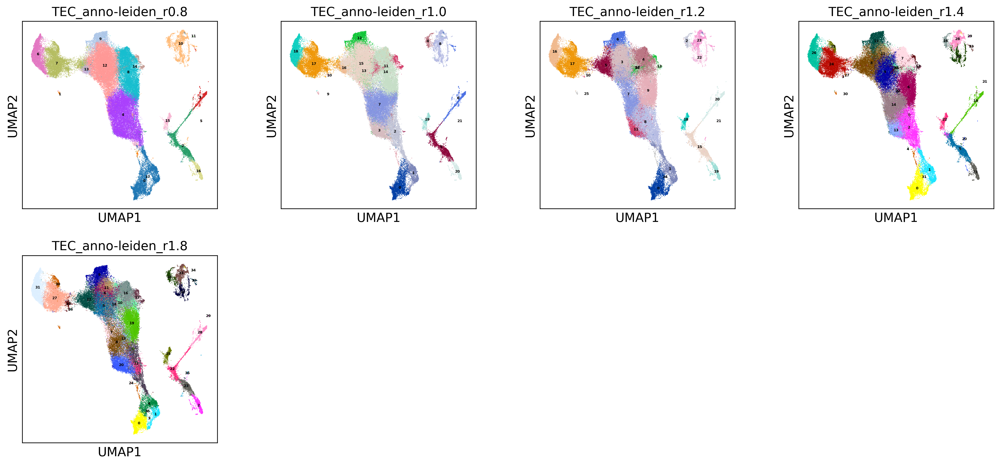

In [35]:
run_leiden(adata, resolutions = [0.8, 1.0, 1.2, 1.4, 1.8], key_name = 'TEC_anno')

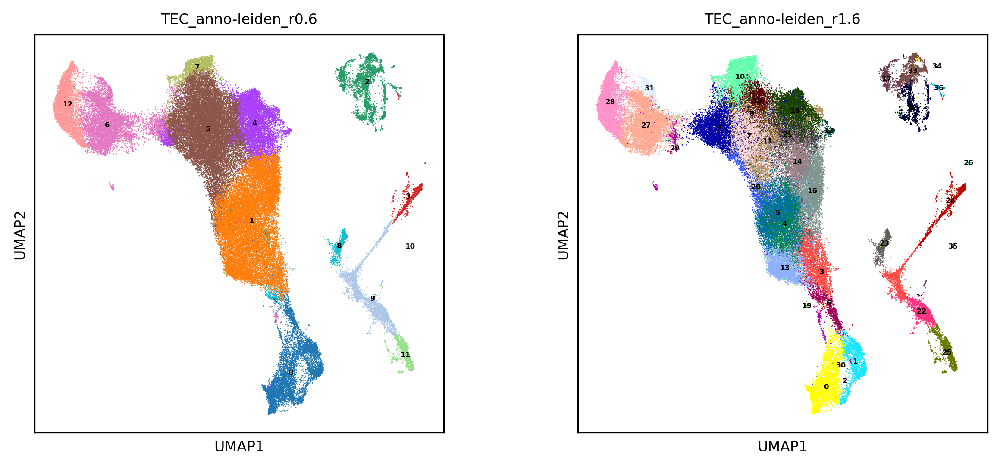

In [85]:
run_leiden(adata, resolutions = [0.6, 1.6], key_name = 'TEC_anno')

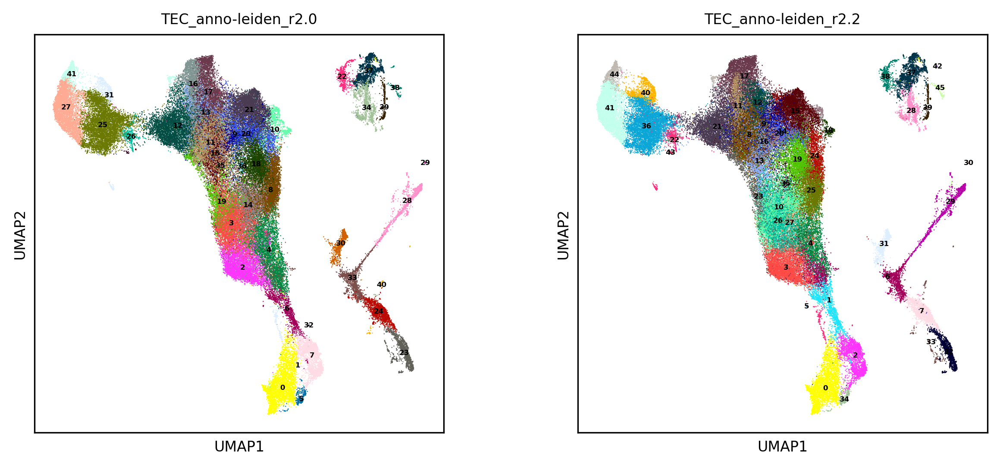

In [88]:
run_leiden(adata, resolutions = [2.0, 2.2], key_name = 'TEC_anno')

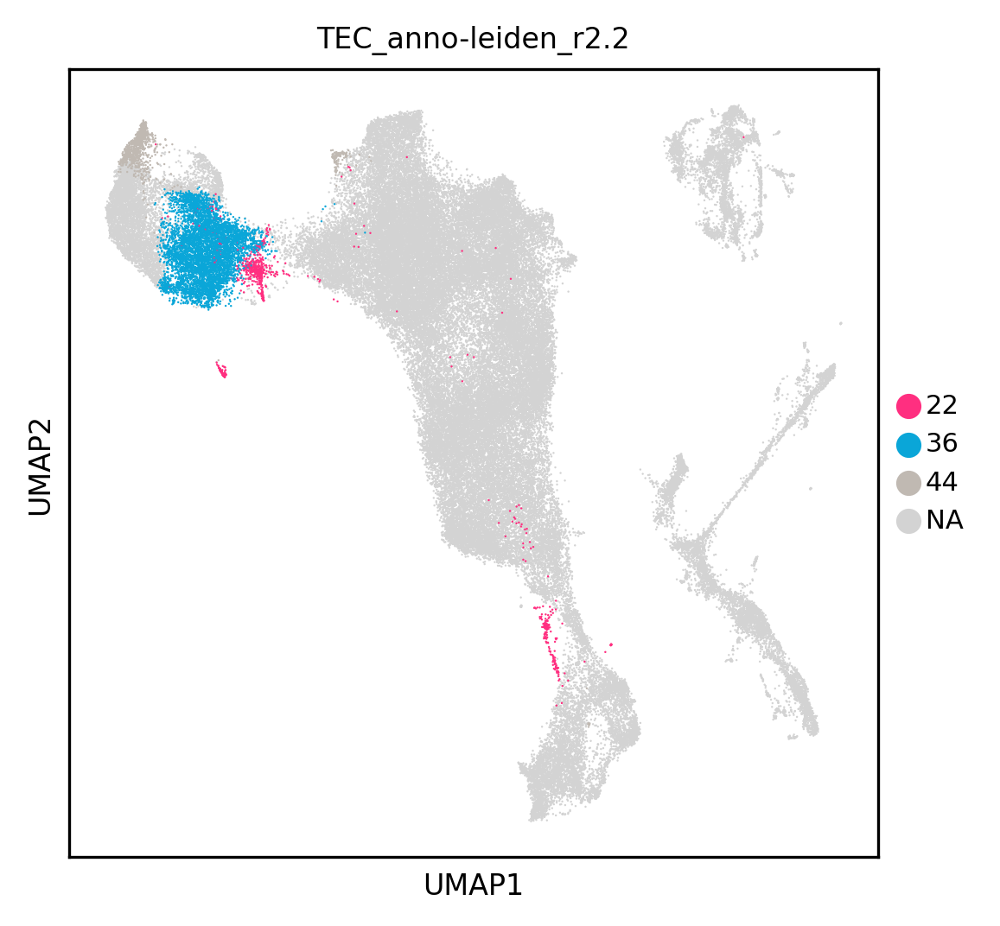

In [91]:
sc.pl.umap(adata, color = 'TEC_anno-leiden_r2.2', groups = ['44', '36', '22'])

In [95]:
np.sum(adata.obs['scrublet_score']>0.4)

438

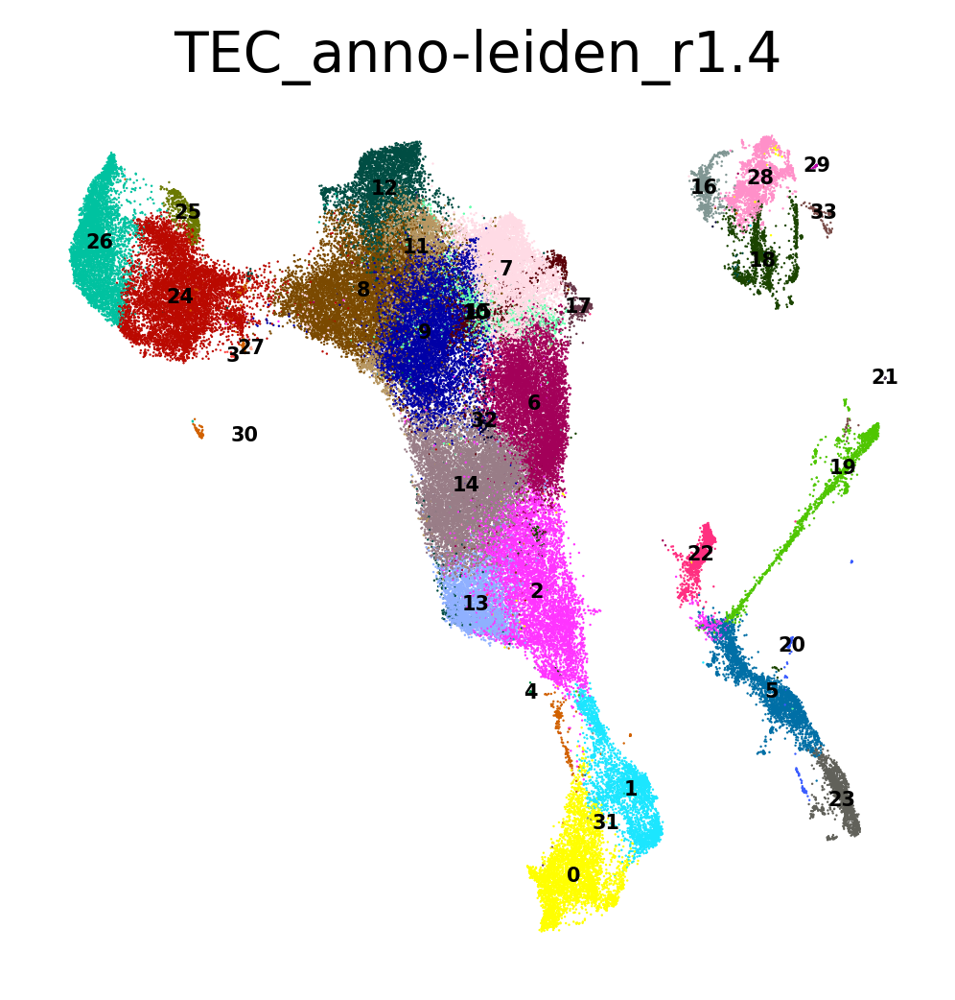

In [39]:
sc.pl.umap(adata, color = 'TEC_anno-leiden_r1.4', legend_loc = 'on data', legend_fontsize = 5, frameon = False)

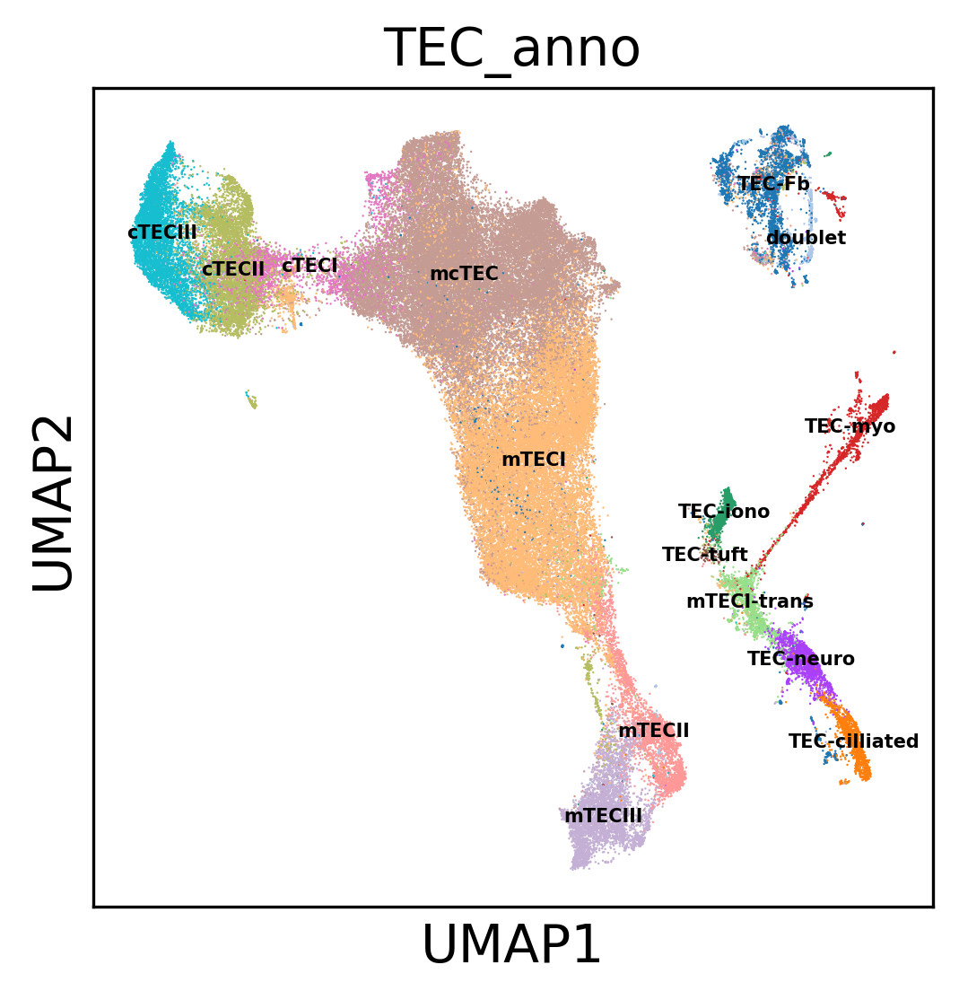

In [36]:
sc.pl.umap(adata, color = 'TEC_anno', legend_loc = 'on data', legend_fontsize = 5)

In [181]:
def scvi_markers_enrich(vae, adata_input, cluster, prep_vae = True, enrich = True, n_markers=5):
    if prep_vae:
        vae.adata.obs[cluster] = adata_input.obs.reindex(vae.adata.obs_names)[cluster].copy()
    results = {}
    de_mrks_dict = {}
    de_df = vae.differential_expression(
    groupby=cluster)
    de_df['cluster'] = [i.replace(" vs Rest","") for i in de_df['comparison']]
    de_df.head()
    markers = {}
    cats = vae.adata.obs[cluster].cat.categories
    for i, c in enumerate(cats):
        cid = "{} vs Rest".format(c)
        cell_type_df = de_df.loc[de_df.comparison == cid]
        cell_type_df = cell_type_df[cell_type_df.lfc_mean > 0.25]
        cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 3]
        cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.1]
        de_mrks_dict[c]=cell_type_df.index.tolist() 
        markers[c] = cell_type_df.index.tolist()[:n_markers]
    #enrich_df = pdDataFrame()
    if enrich:
        enrich_df = sc.queries.enrich(de_mrks_dict,gprofiler_kwargs={'sources': ['GO:BP', 'REAC', 'KEGG'], 
                                                                     'no_evidences': False, 'all_results': True}, 
                                      org="hsapiens")
        enrich_df.significant = enrich_df.p_value<0.1
        enrich_df = enrich_df.loc[((enrich_df.term_size > 10) & (enrich_df.term_size < 500)) & (enrich_df.significant == True)].reset_index(drop = True)
        print(f"Number of significant genes:{str(enrich_df.significant.sum())}")
    results['de_df'] = de_df
    results['markers'] = markers
    results['enrich'] = enrich_df
    #print(results)
    return(results)

In [46]:
from gprofiler import GProfiler

In [51]:
scvi_mrkrs_r1p4 = scvi_markers_enrich(vae = scvi_run['vae'], cluster = 'TEC_anno-leiden_r1.4')

DE...: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [11:52<00:00, 20.95s/it]
Number of significant genes:2387


In [59]:
scvi_mrkrs_r1p4['enrich'].loc[scvi_mrkrs_r1p4['enrich']['query'] == '28'].iloc[0:20]

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents,intersections,evidences
26,REAC,REAC:R-HSA-1474244,Extracellular matrix organization,8.919655e-23,True,Extracellular matrix organization,297,131,35,10842,0.267176,0.117845,28,[REAC:0000000],"[LAMA2, LUM, COL15A1, A2M, FBLN5, MMP2, PCOLCE...","[[REAC], [REAC], [REAC], [REAC], [REAC], [REAC..."
33,GO:BP,GO:0030198,extracellular matrix organization,3.512285e-20,True,"""A process that is carried out at the cellular...",324,167,30,21031,0.179641,0.092593,28,"[GO:0043062, GO:0045229]","[LAMA2, LUM, DPT, COL15A1, SFRP2, FBLN5, MMP2,...","[[NAS], [NAS], [IBA, IEA], [IBA], [IEA], [IMP,..."
36,GO:BP,GO:0043062,extracellular structure organization,3.844755e-20,True,"""A process that is carried out at the cellular...",325,167,30,21031,0.179641,0.092308,28,[GO:0016043],"[LAMA2, LUM, DPT, COL15A1, SFRP2, FBLN5, MMP2,...","[[NAS], [NAS], [IBA, IEA], [IBA], [IEA], [IMP,..."
38,GO:BP,GO:0045229,external encapsulating structure organization,4.207382e-20,True,"""A process that is carried out at the cellular...",326,167,30,21031,0.179641,0.092025,28,[GO:0016043],"[LAMA2, LUM, DPT, COL15A1, SFRP2, FBLN5, MMP2,...","[[NAS], [NAS], [IBA, IEA], [IBA], [IEA], [IMP,..."
94,REAC,REAC:R-HSA-1474228,Degradation of the extracellular matrix,9.690063e-14,True,Degradation of the extracellular matrix,140,131,20,10842,0.152672,0.142857,28,[REAC:R-HSA-1474244],"[COL15A1, A2M, MMP2, NID1, CTSK, COL1A2, COL6A...","[[REAC], [REAC], [REAC], [REAC], [REAC], [REAC..."
150,REAC,REAC:R-HSA-3000178,ECM proteoglycans,8.247288e-11,True,ECM proteoglycans,75,131,14,10842,0.106870,0.186667,28,[REAC:R-HSA-1474244],"[LAMA2, LUM, COL1A2, COL6A3, LAMA4, COL4A1, BG...","[[REAC], [REAC], [REAC], [REAC], [REAC], [REAC..."
156,GO:BP,GO:0031589,cell-substrate adhesion,1.391961e-10,True,"""The attachment of a cell to the underlying su...",351,167,22,21031,0.131737,0.062678,28,[GO:0007155],"[APOD, SVEP1, FBLN5, MYOC, SNED1, NID1, CD34, ...","[[IMP], [IEA], [TAS], [IDA], [IEA], [IEA], [IS..."
167,GO:BP,GO:0045765,regulation of angiogenesis,3.030002e-10,True,"""Any process that modulates the frequency, rat...",288,167,20,21031,0.119760,0.069444,28,"[GO:0001525, GO:0022603, GO:1901342]","[SFRP2, HSPB6, CD34, SMOC2, THBS2, ANGPTL4, EN...","[[ISS, IEA], [IDA], [IDA], [IDA, IGI], [IDA, I..."
172,GO:BP,GO:1901342,regulation of vasculature development,4.182484e-10,True,"""Any process that modulates the frequency, rat...",293,167,20,21031,0.119760,0.068259,28,"[GO:0001944, GO:2000026]","[SFRP2, HSPB6, CD34, SMOC2, THBS2, ANGPTL4, EN...","[[ISS, IEA], [IDA], [IDA], [IDA, IGI], [IDA, I..."
193,REAC,REAC:R-HSA-3000171,Non-integrin membrane-ECM interactions,1.272757e-09,True,Non-integrin membrane-ECM interactions,58,131,12,10842,0.091603,0.206897,28,[REAC:R-HSA-1474244],"[LAMA2, COL1A2, LAMA4, DDR2, COL4A1, COL4A2, S...","[[REAC], [REAC], [REAC], [REAC], [REAC], [REAC..."


In [53]:
scvi_mrkrs_r1p4['enrich']['query'].value_counts()

query
18    271
28    200
33    190
1     184
19    172
23    150
4     137
5     131
21    124
29    112
20    109
31     98
26     64
3      56
24     55
0      53
16     49
30     39
17     36
27     33
22     29
25     25
15     18
32     17
2      13
10      8
13      8
7       6
Name: count, dtype: int64

In [82]:
sc.settings.set_figure_params(dpi = 150, fontsize = 8, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

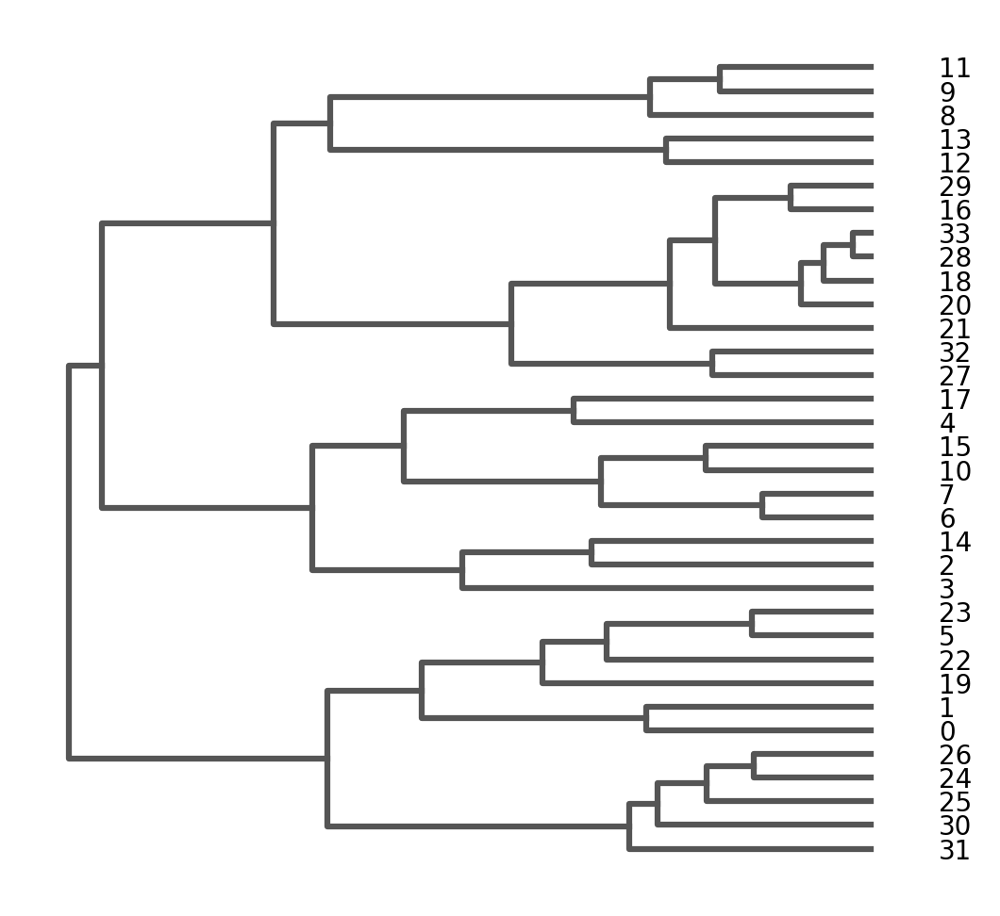

<Axes: >

In [83]:
#rc.Params.figsize = (14, 12)
sc.pl.dendrogram(adata, groupby = 'TEC_anno-leiden_r1.4', orientation = 'left')

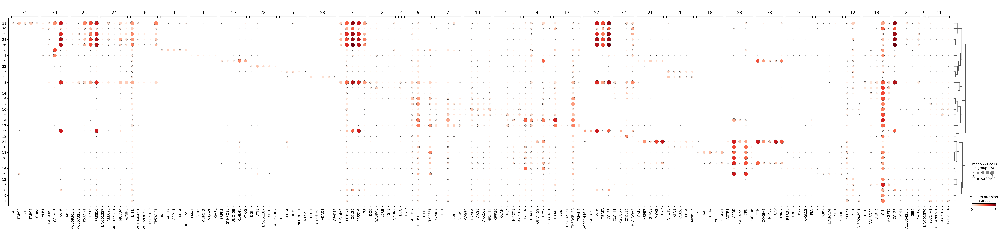

In [65]:
sc.pl.dotplot(adata, groupby = 'TEC_anno-leiden_r1.4', var_names= scvi_mrkrs_r1p4['markers'], dendrogram=True)

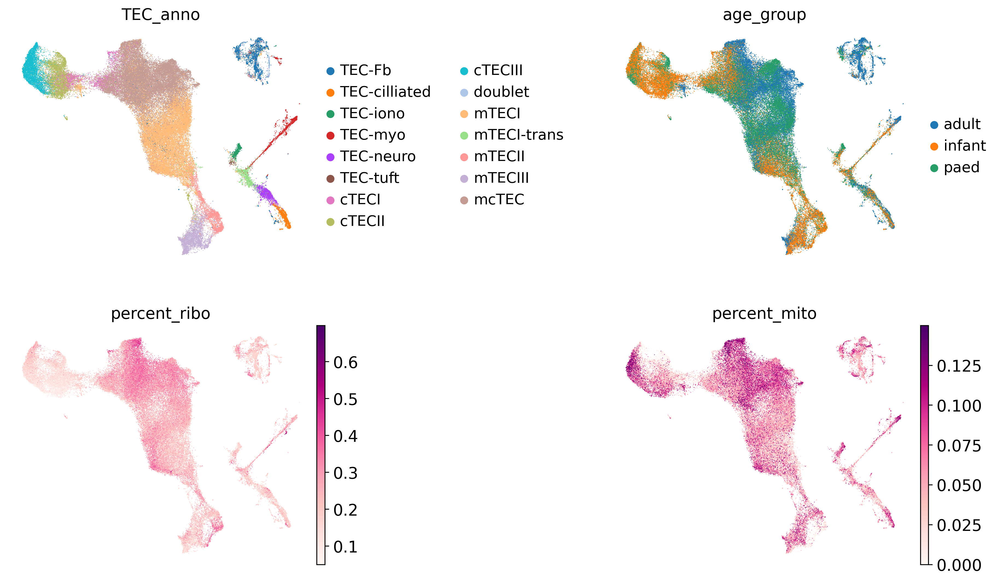

In [32]:
sc.pl.umap(adata, color = ['TEC_anno', 'age_group', 'percent_ribo', 'percent_mito'], wspace = 0.8, ncols = 2, frameon = False)

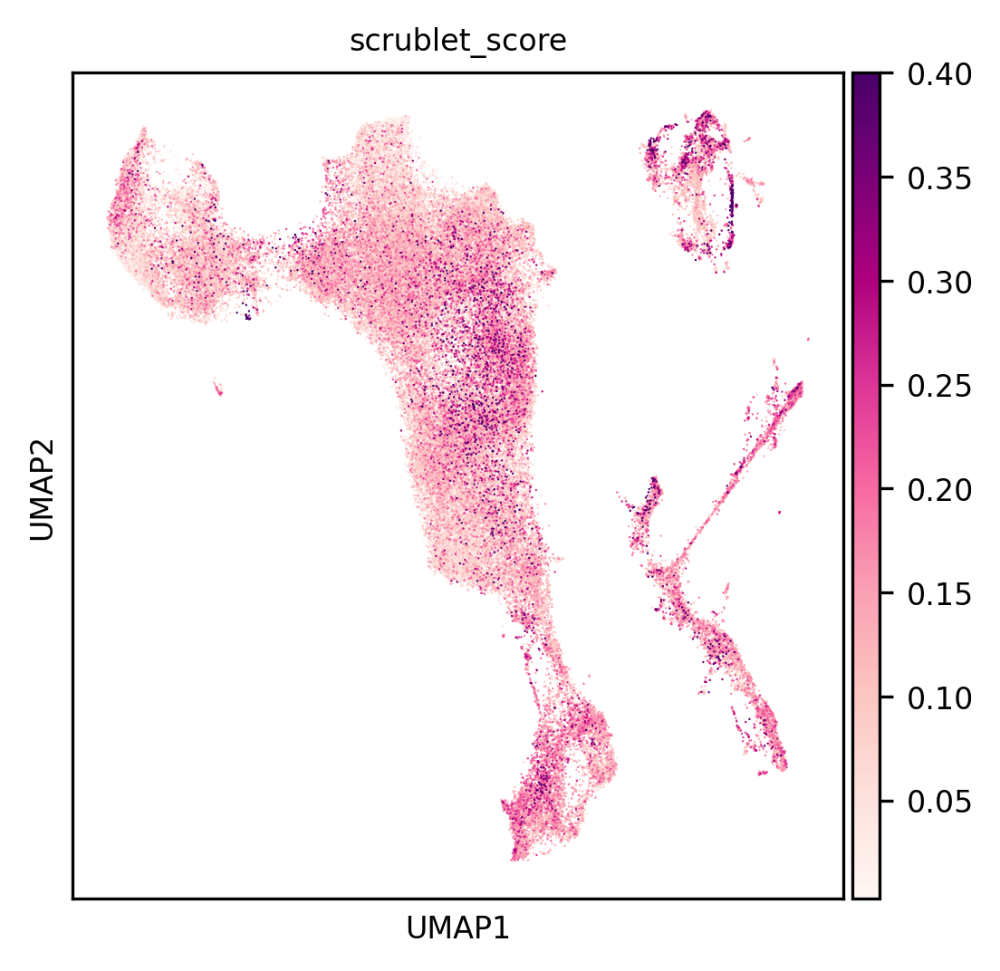

In [93]:
sc.pl.umap(adata, color = 'scrublet_score', vmax = 0.4)

In [96]:
adata_dbrm= adata[adata.obs['scrublet_score']<0.4,].copy()

In [100]:
import celltypist
model_taa_l4 = celltypist.Model.load('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/models/Celltypist_mod_thyAge_scvi_v2_pop_mrkrs_taa_l4_2024-12-10.pkl')

predictions_l4 = celltypist.annotate(adata_dbrm, model=model_taa_l4, majority_voting = True)
predictions_l4.to_adata(prefix='ctypist_taa_l4')

🔬 Input data has 90016 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 6783 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 20
🗳️ Majority voting the predictions
✅ Majority voting done!


AnnData object with n_obs × n_vars = 90016 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'doublet', 'stroma-anno1-coarse', 'stroma-anno1-granular', 'stroma-anno2-coarse', 'stroma-anno2-granular', 'doublet_verbose', 'TEC-leiden_r1.8', 'TEC_anno', 'study-age', 'TEC_anno-leiden_r0.8', 'TEC_anno-leiden_r1.0', 'TEC_anno-leiden_r1.2', 'TEC_anno-leiden_r1.4'

In [109]:
adata_dbrm2 = adata_dbrm[~adata_dbrm.obs['ctypist_taa_l4majority_voting'].isin(['EC-ven_peri', 'Fb-perilo']),:].copy()

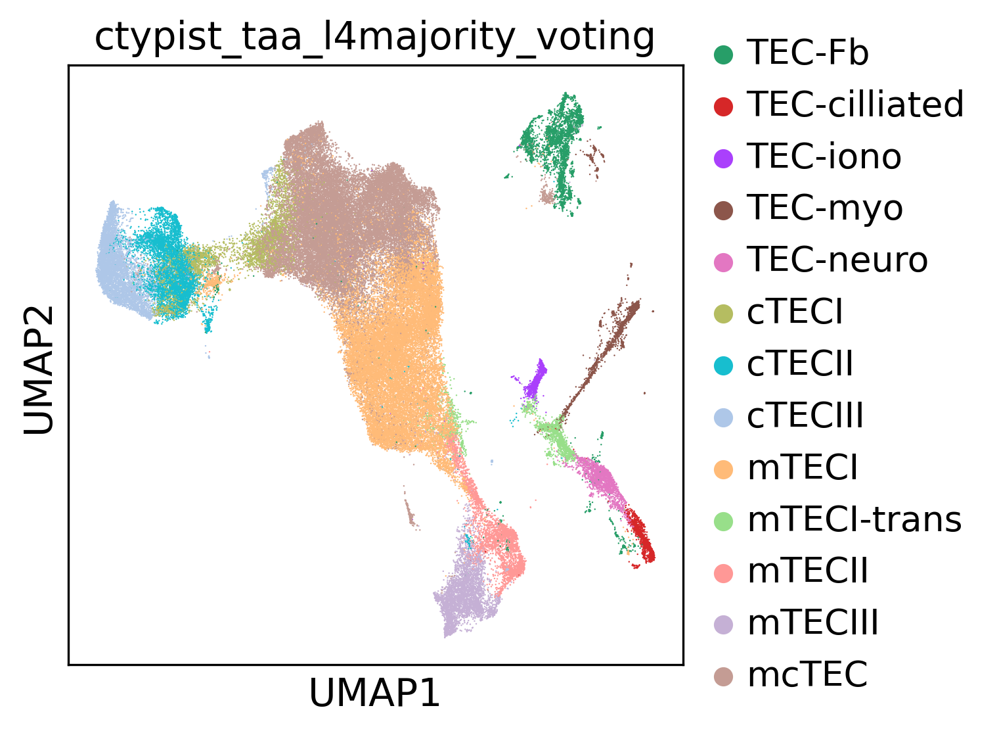

AnnData object with n_obs × n_vars = 89710 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'doublet', 'stroma-anno1-coarse', 'stroma-anno1-granular', 'stroma-anno2-coarse', 'stroma-anno2-granular', 'doublet_verbose', 'TEC-leiden_r1.8', 'TEC_anno', 'study-age', 'TEC_anno-leiden_r0.8', 'TEC_anno-leiden_r1.0', 'TEC_anno-leiden_r1.2', 'TEC_anno-leiden_r1.4'

In [112]:
regen_embed(adata_dbrm2, 'ctypist_taa_l4majority_voting')

In [104]:
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

In [113]:
sc.pl.umap(adata_dbrm2, color = tec_mrkrs_lst)

In [121]:
import celltypist
model_taa_l1 = celltypist.Model.load('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/models/Celltypist_mod_thyAge_scvi_v2_pop_mrkrs_taa_l1_2024-12-10.pkl')

predictions_l1 = celltypist.annotate(adata_dbrm2, model=model_taa_l1, majority_voting = True)
predictions_l1.to_adata(prefix='ctypist_taa_l1')

🔬 Input data has 89710 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 3962 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 20
🗳️ Majority voting the predictions
✅ Majority voting done!


AnnData object with n_obs × n_vars = 89710 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'doublet', 'stroma-anno1-coarse', 'stroma-anno1-granular', 'stroma-anno2-coarse', 'stroma-anno2-granular', 'doublet_verbose', 'TEC-leiden_r1.8', 'TEC_anno', 'study-age', 'TEC_anno-leiden_r0.8', 'TEC_anno-leiden_r1.0', 'TEC_anno-leiden_r1.2', 'TEC_anno-leiden_r1.4'

In [122]:
import celltypist
model_taa_l4 = celltypist.Model.load('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/models/Celltypist_mod_thyAge_scvi_v2_pop_mrkrs_taa_l4_2024-12-10.pkl')

predictions_l4 = celltypist.annotate(adata_dbrm2, model=model_taa_l4, majority_voting = True)
predictions_l4.to_adata(prefix='ctypist_taa_l4')

🔬 Input data has 89710 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 6783 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 20
🗳️ Majority voting the predictions
✅ Majority voting done!


AnnData object with n_obs × n_vars = 89710 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'doublet', 'stroma-anno1-coarse', 'stroma-anno1-granular', 'stroma-anno2-coarse', 'stroma-anno2-granular', 'doublet_verbose', 'TEC-leiden_r1.8', 'TEC_anno', 'study-age', 'TEC_anno-leiden_r0.8', 'TEC_anno-leiden_r1.0', 'TEC_anno-leiden_r1.2', 'TEC_anno-leiden_r1.4'

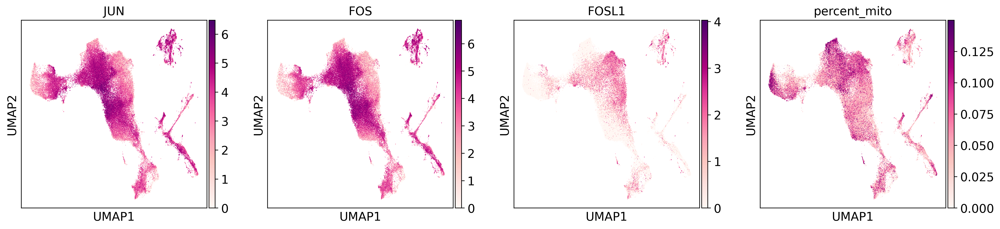

In [118]:
sc.pl.umap(adata_dbrm2, color = ['JUN', 'FOS', 'FOSL1', 'percent_mito'])

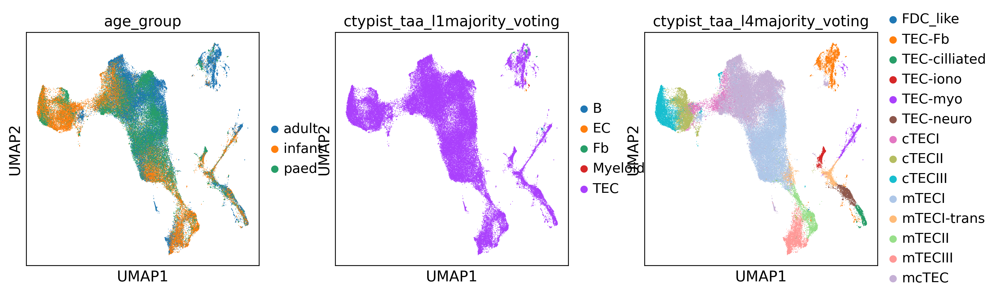

In [123]:
sc.pl.umap(adata_dbrm2, color = ['age_group', 'ctypist_taa_l1majority_voting', 'ctypist_taa_l4majority_voting'])

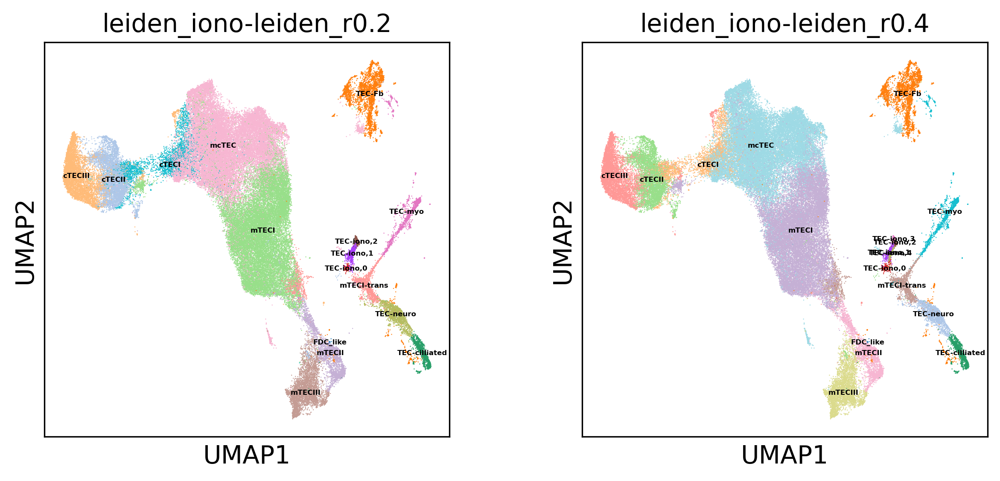

In [131]:
run_leiden(adata_dbrm2, resolutions = [0.2, 0.4], key_name = 'leiden_iono', 
           restrict_to=['ctypist_taa_l4majority_voting', ['TEC-iono']])

In [137]:
adata_dbrm2.obs['TEC_anno'] = adata_dbrm2.obs['leiden_iono-leiden_r0.4'].apply(lambda x:
                                                                              'TEC-tuft' if x == 'TEC-iono,0' else
                                                                               'TEC-iono' if 'iono' in x else
                                                                              'mTECII' if x == 'FDC_like' else
                                                                              'TEC-EMT' if x == 'TEC-Fb' else 
                                                                              x)

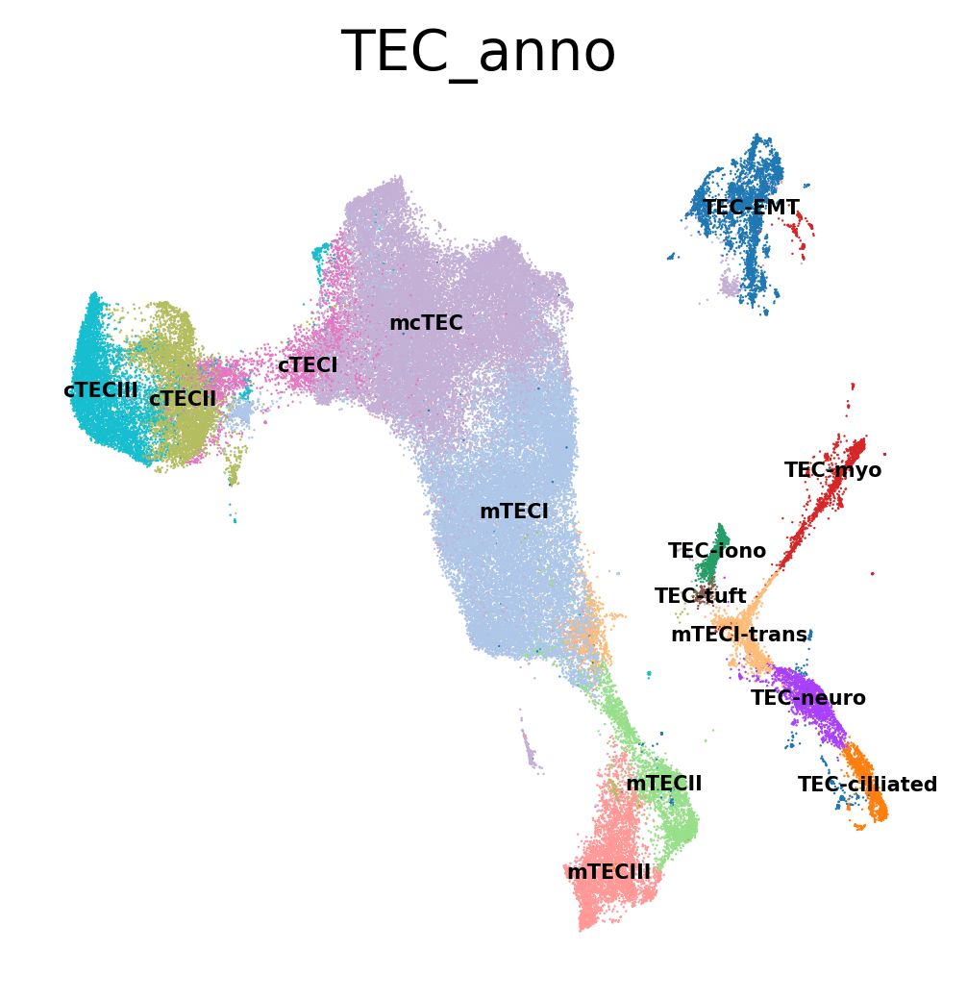

In [141]:
sc.pl.umap(adata_dbrm2, color = 'TEC_anno', frameon = False, legend_loc = 'on data', legend_fontsize = 5)

In [150]:
tec_levels = ['cTECIII', 'cTECII', 'cTECI', 'mcTEC',  'mTECI', 'mTECI-trans', 'TEC-EMT', 'mTECII',
                                     'mTECIII', 'TEC-neuro', 'TEC-cilliated','TEC-myo', 'TEC-iono', 'TEC-tuft' ]

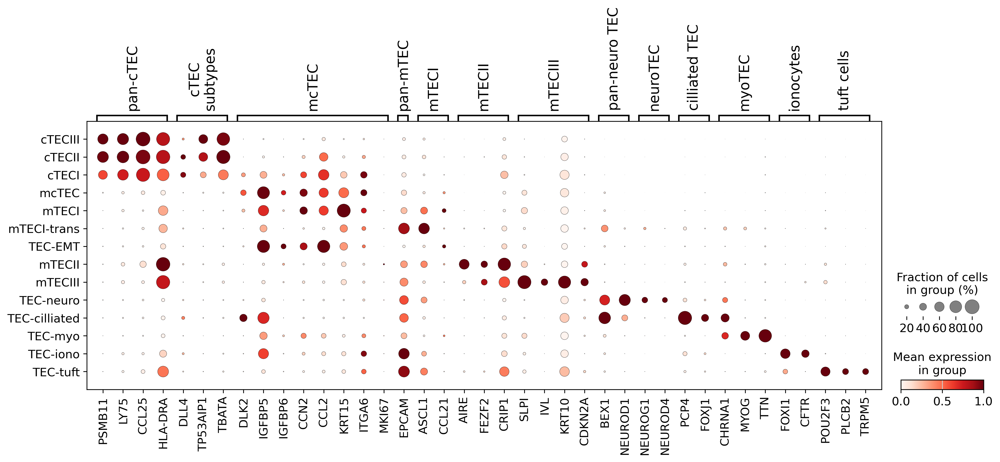

In [155]:
sc.pl.dotplot(adata_dbrm2, var_names = tec_mrkrs, groupby='TEC_anno', standard_scale = 'var')

In [149]:
adata_dbrm2.obs.to_csv(f'{data_path}/objects/thyAgeing_scvi_v3_2024-11-05_tec-fb-vascSplit_TEC_v4_2layers_400epochs_batch-sample_anno_2025-01-13.csv')

In [162]:
sc.pp.scale(adata_dbrm2)

sc.tl.score_genes (adata_dbrm2, gene_list = aatec1, ctrl_size = len(aatec1), score_name = "aatec1_score")
sc.tl.score_genes (adata_dbrm2, gene_list = aatec2, ctrl_size = len(aatec2), score_name = "aatec2_score")

sc.tl.score_genes (adata_dbrm2, gene_list = mhc1, ctrl_size = len(mhc1), score_name = "mhc1_score")
sc.tl.score_genes (adata_dbrm2, gene_list = mhc2, ctrl_size = len(mhc2), score_name = "mhc2_score")
sc.tl.score_genes (adata_dbrm2, gene_list = HLM_EMT, ctrl_size = len(HLM_EMT), score_name = "emt_score")

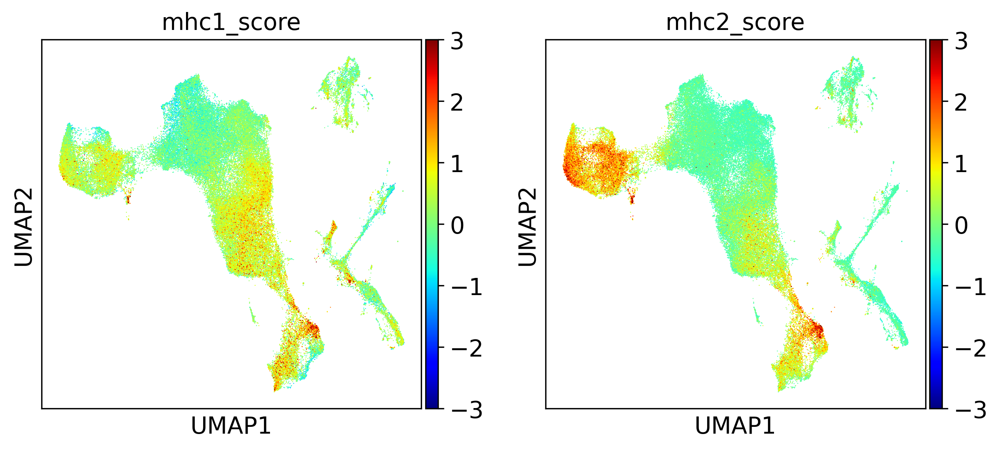

In [164]:
sc.pl.umap(adata_dbrm2, color = ["mhc1_score", "mhc2_score"], cmap = 'jet', vcenter = 0, vmax = 3, vmin = -3)

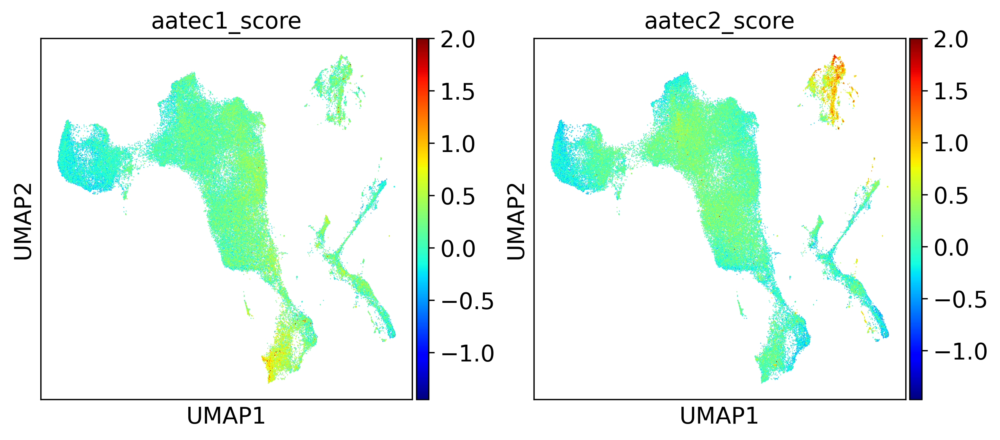

In [168]:
sc.pl.umap(adata_dbrm2, color = ["aatec1_score", "aatec2_score"], cmap = 'jet', vmax = 2)

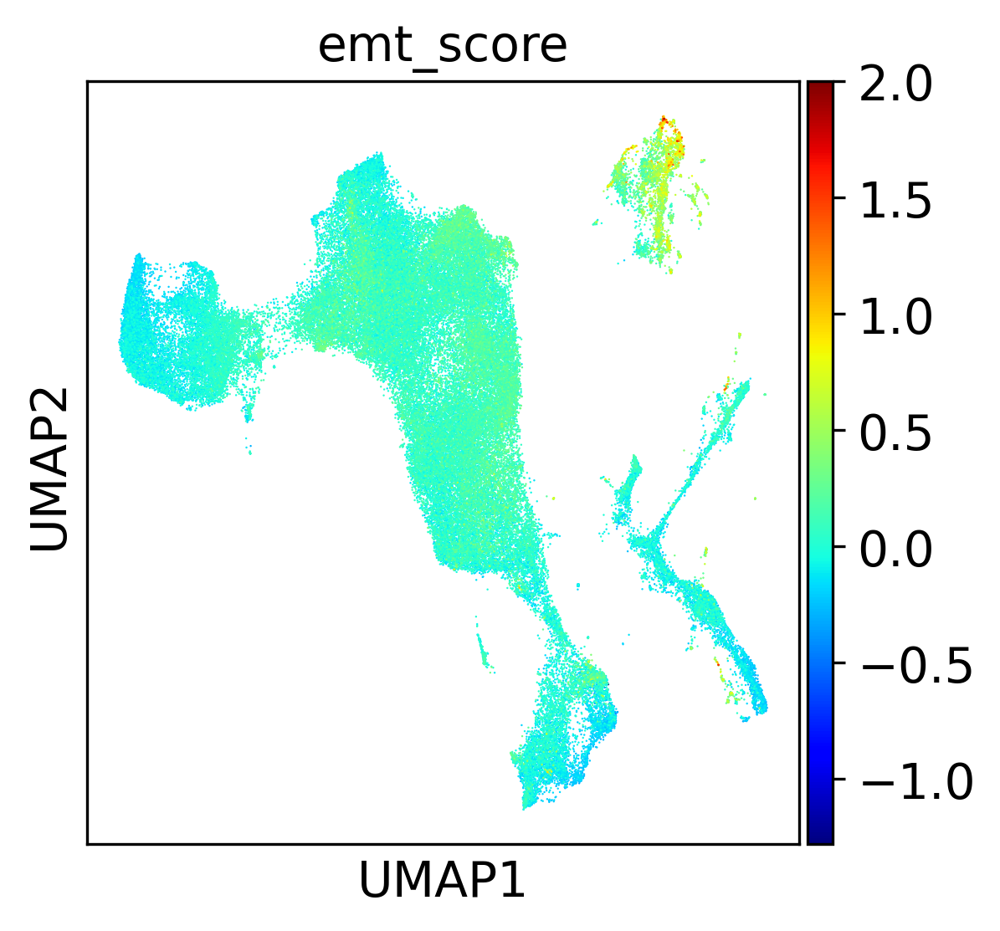

In [171]:
sc.pl.umap(adata_dbrm2, color = ["emt_score"], cmap = 'jet', vmax = 2)